In [1]:
# check for retweets..
# visulalize heat map of those that only follow each other..
# user-user graph of who follow each other

In [100]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import pickle
import ast
import networkx as nx
import ast
from collections import deque

In [749]:
pd.set_option('display.max_colwidth', -1)

In [3]:
# following data for user...
df_300 = pd.read_csv("~/Following300_1220.csv",index_col=0)
df_keys = pd.read_csv("~/keys.csv",encoding = "utf-8")
df_user = pd.read_csv("/home/akshayuppal3/hexagonData.csv",lineterminator="\n")

In [11]:
# new following data
df_following_i3000 = pd.read_csv("/home/akshayuppal3/following_compl_i3000.csv")
df_foll = pd.read_csv("/home/akshayuppal3/following_0401.csv")
df_hex = pd.read_csv("/home/akshayuppal3/hexagonData.csv",lineterminator="\n")

In [12]:
# final user df_following complete and get the following graph
df_foll.reset_index(drop=True, inplace=True)

In [14]:
len(df_foll)

7179

In [15]:
# users
users = list(df_foll.userID.unique())

In [16]:
with open("user-user_c.edgelist","w+") as f:
    for userA in tqdm(users):
        if (userA in list(df_foll.userID.unique())):
            follA = set(ast.literal_eval((df_foll['following'].loc[df_foll.userID == userA].values)[0]))
            user_sub = set([ele for ele in users if ele != userA])
            foll_sub = list(user_sub - (user_sub - follA))
            for foll in foll_sub: # edges with all the following network
                f.write(str(userA) + " " + str(foll) + "\n")

100%|██████████| 7179/7179 [00:52<00:00, 136.50it/s]


In [19]:
G = nx.read_edgelist("user-user_c.edgelist",create_using=nx.DiGraph())

In [20]:
len(G.edges())

55574

In [590]:
plt.figure(figsize =(80,80))
nx.draw_networkx(G)
plt.savefig("user-user-conenction")

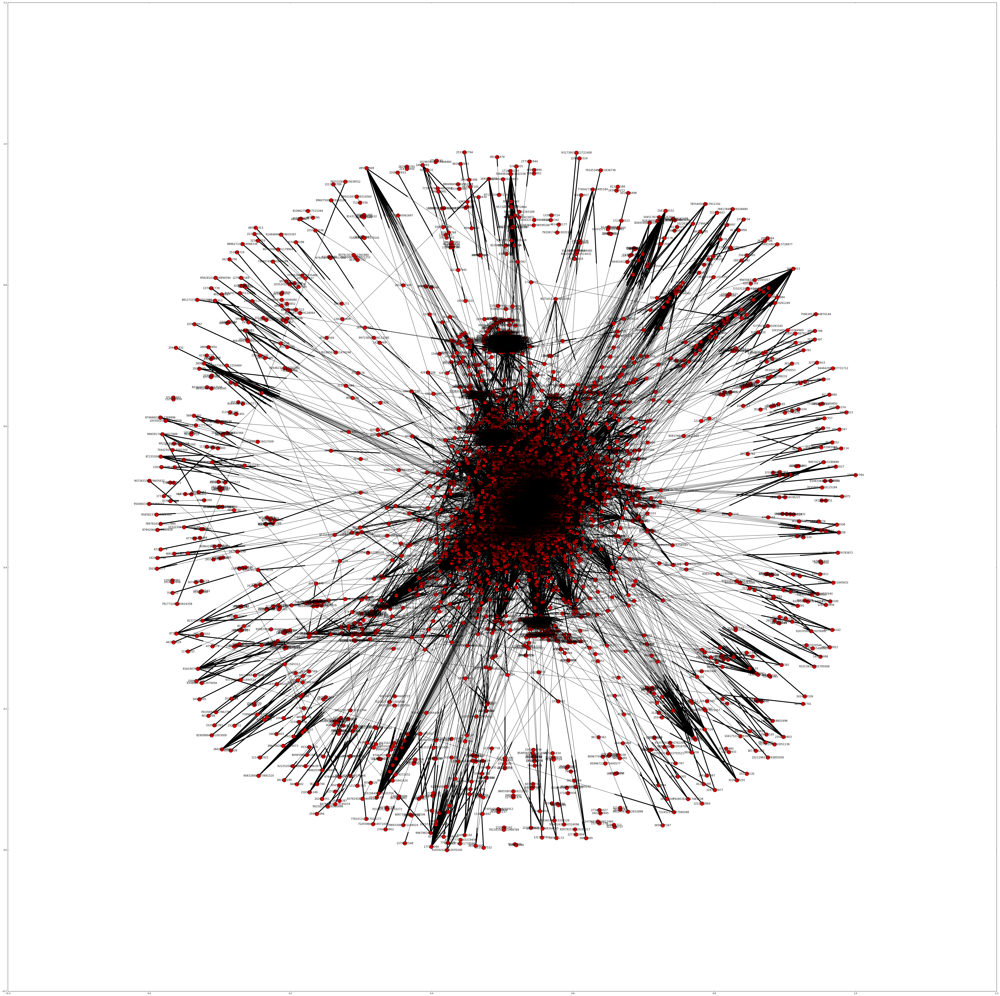

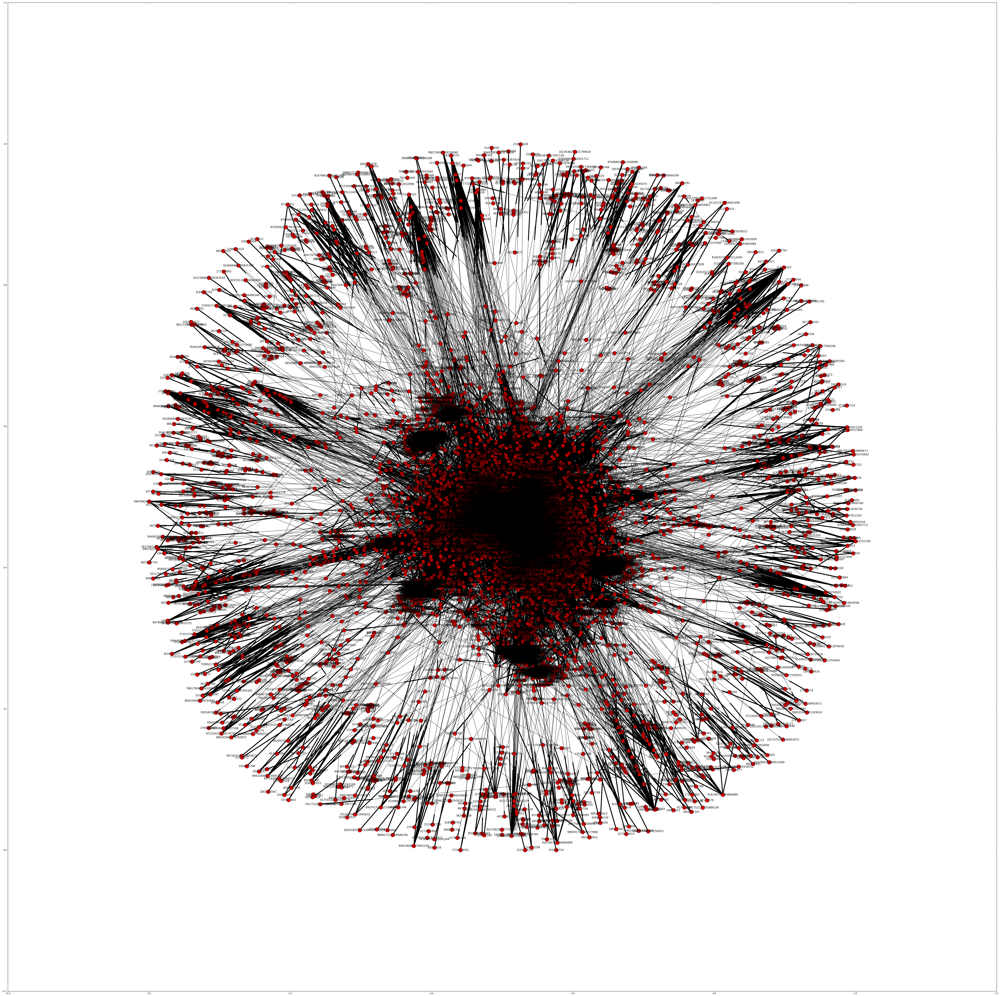

In [591]:
plt.show()

In [601]:
# for retweet loading the dataframe
df_user= pd.read_csv("/home/akshayuppal3/hexagonData.csv",lineterminator="\n")
df_timeline = pd.read_csv("/home/akshayuppal3/userTimelineData.csv",lineterminator="\n")

In [610]:
len(df_timeine[df_timeine.retweeted == True])

0

In [615]:
len(df_user[df_user.retweeted == True])

0

In [721]:
# based on the juul dataset
df_retweets = pd.DataFrame({'retweets':list(df_user['retweetCount']),
                            'tweetId':list(df_user['tweetId']),
                            'userID': list(df_user['userID'])}
                          )

In [712]:
df_ret = df_retweets.groupby('userID')['retweets'].max()

In [713]:
df_ret = df_ret.reset_index()
df_ret = pd.DataFrame(df_ret)

In [714]:
df_retf = df_ret.groupby('retweets')['userID'].agg({'count':'count'})
df_retf = df_retf.reset_index()

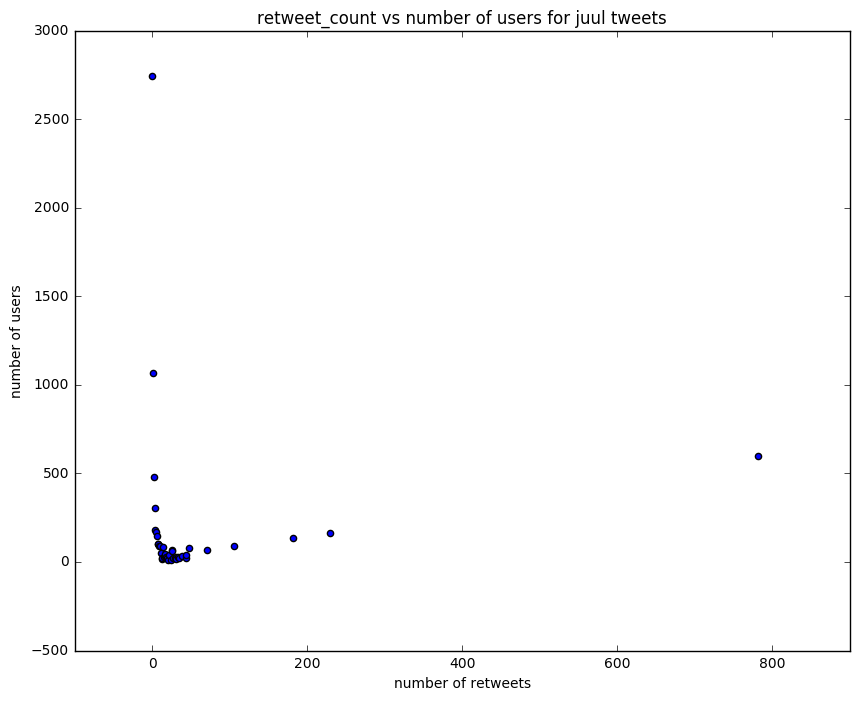

In [717]:
# to check the picture of retweets
plt.figure(figsize=(10,8))
plt.scatter(list(df_retf.retweets[0:]),list(df_retf['count'][0:]))
plt.title("retweet_count vs number of users for juul tweets")
plt.xlabel("number of retweets")
plt.ylabel("number of users")
plt.show()

In [753]:
# so we found two tweets based om the above graph that have been retweeted a lot
df_tweets_sub = df_user[df_user['retweetCount'] >=100]

In [754]:
# so there are threee that are most highly retweeted so will be basing the cascade om this
df_tweets_sub.groupby('retweetCount')['tweetText'].min()

retweetCount
106    This is an epidemic: half of all high school students in MA have tried vaping. Students are using e-cigarettes at higher rates than adults.  The FDA is taking the right step here. Our investigation into #JUUL continues. https://t.co/r9mIlhr2EX
182    The #Juul ruining friendships pt.2 https://t.co/xGno0mLpwp                                                                                                                                                                                         
229    Regarding recent inquiries involving #JUUL, please read our official statement:  https://t.co/z8P5KRLsYO https://t.co/FBTg3Kwegk                                                                                                                   
781    Team tatted... 😤🤘🏻 Yup!!! 🤬🤬🤬🤬 Hurt like a bitch but it was so worth it.  🤑🤑🤑🤑 #juul #tattoo #CaptionThis https://t.co/88RXkzY6Oe                                                                                                  

In [ ]:
# to gather the data based on teh high retweets .... so select those users with high retweets and then form the cascades
# so retweet count give the retweet count of teh tweetId so will select the tweets with high tweetID

In [60]:
# tweet for the juul officila statement
df_juul_retweet = df_tweets_sub[df_tweets_sub.retweetCount == 229]

In [61]:
df_juul_retweet['tweetCreatedAt'] = pd.to_datetime(df_juul_retweet['tweetCreatedAt'])

/home/akshayuppal3/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [62]:
# so we got it, the source as Juul which verifies as it is official juul statement
df_juul_retweet.sort('tweetCreatedAt').head(1)

/home/akshayuppal3/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,favourites_count,friendList,friendsCount,hashtags,imageurl,lang,retweetCount,retweeted,tweetCreatedAt,tweetId,tweetText,userCreatedAt,userDescription,userFollowersCount,userID,userLocation,userName
2755,668,None,371,['JUUL'],http://pbs.twimg.com/profile_images/5903959479...,en,229,False,2018-02-08 00:17:49,961393593998086144,"Regarding recent inquiries involving #JUUL, pl...",2014-12-03 23:28:22,"At JUUL, our mission is to improve the lives o...",19708,2918018660,San Francisco,JUUL


In [72]:
df_juul_retweet.reset_index(inplace=True,drop=True)

In [63]:
len(df_juul_retweet.userID.unique())

166

In [64]:
## so it exits .. lets check the edges
'2918018660' in (G.nodes())

True

In [65]:
# so it is connected to lot of edges
len(G.edges('2918018660'))

33

In [66]:
G_juul = nx.DiGraph()
G_juul.add_edges_from(G.edges('2918018660'))

In [94]:
juul_node = '2918018660'

In [68]:
color_map1 = list()
for node in G_juul.nodes():
    if node != '2918018660':
        color_map1.append("red")
    else:
        color_map1.append("yellow")

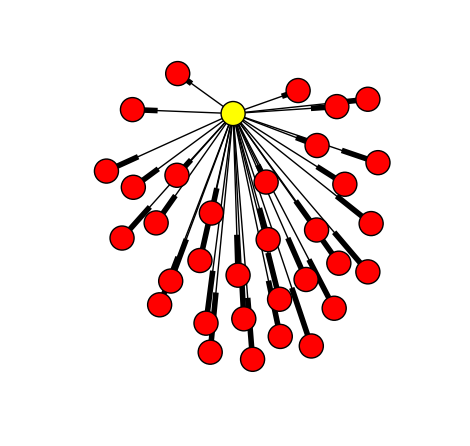

In [828]:
# orginal JUUL following graph --dont rum
plt.figure(figsize=(4,4))
nx.draw(G_juul,node_color=color_map1)
plt.show()

In [837]:
len(df_juul_retweet.userID)

166

In [840]:
len(G_juul.nodes())

34

In [95]:
len(G_juul.edges())

33

In [119]:
user_juul = (list(df_juul_retweet.userID.unique()))

In [140]:
relation_obj = api.show_friendship(source_id = 2918018660, target_id = str(user_juul[2]))[1]
realtion_obj

Friendship(blocked_by=None, following_requested=None, want_retweets=None, notifications_enabled=None, live_following=False, _api=<tweepy.api.API object at 0x7f5462cbb518>, can_dm=True, all_replies=None, following_received=None, id=2918018660, following=True, screen_name='JUULvapor', blocking=None, muting=None, id_str='2918018660', followed_by=True, marked_spam=None)

In [135]:
2918018660

2918018660

In [139]:
juul_node = 2918018660

In [145]:
juul_node in user_juul

True

In [147]:
# check al teh relation with te juul node
with open("juul.edgelist","w+") as f: 
    for user in tqdm(user_juul):
        apis.rotate(-1)
        api = apis[0]
        relation_obj1 = api.show_friendship(source_id = juul_node, target_id = (user))[0]
        if (user != juul_node):
            if (relation_obj1.following == True):
                f.write(str(juul_node) + " " + str(user)+"\n")
            elif (realtion_obj.followed_by == True):
                f.write(str(user) + " " + str(juul_node)+"\n")







  0%|          | 0/166 [00:00<?, ?it/s]





  1%|          | 1/166 [00:00<00:32,  5.13it/s]





  1%|          | 2/166 [00:00<00:31,  5.23it/s]





  2%|▏         | 3/166 [00:00<00:30,  5.34it/s]





  2%|▏         | 4/166 [00:00<00:30,  5.39it/s]





  3%|▎         | 5/166 [00:00<00:29,  5.41it/s]





  4%|▎         | 6/166 [00:01<00:29,  5.40it/s]





  4%|▍         | 7/166 [00:01<00:30,  5.13it/s]





  5%|▍         | 8/166 [00:01<00:31,  5.02it/s]





  5%|▌         | 9/166 [00:01<00:30,  5.17it/s]





  6%|▌         | 10/166 [00:01<00:29,  5.24it/s]





  7%|▋         | 11/166 [00:02<00:29,  5.31it/s]





  7%|▋         | 12/166 [00:02<00:28,  5.37it/s]





  8%|▊         | 13/166 [00:02<00:28,  5.40it/s]





  8%|▊         | 14/166 [00:02<00:28,  5.41it/s]





  9%|▉         | 15/166 [00:02<00:28,  5.39it/s]





 10%|▉         | 16/166 [00:03<00:30,  4.98it/s]





 10%|█         | 17/166 [00:03<00:29,  5.12it/s]





 11%|█         | 18/166 [00:03<00:28,  5

In [148]:
# plotting for the juul
G_juul_cascade = nx.read_edgelist("juul.edgelist",create_using=nx.DiGraph())

In [150]:
len(G_juul_cascade.edges())

165

In [153]:
len(set(G_juul.nodes())-set(G_juul_cascade.nodes()))

33

## testing

In [54]:
# get the api object
from authentication import Authenticate

In [99]:
ob = Authenticate()
api = ob.api

In [101]:
apis = deque(api)

In [226]:
from collections import deque
d = deque([56,33,1121,1,2])

In [354]:
with open('delete_users.csv', 'a') as f:
    temp.to_csv(f, header=False,ignore_index=True)

In [564]:
list(set([ele for ele in a if ele != 1]) - (set([ele for ele in a if ele != 1]) - set([ele for ele in range(4,8)])))

[4, 5]

In [868]:
import git

def get_git_root(path):

        git_repo = git.Repo(path, search_parent_directories=True)
        git_root = git_repo.git.rev_parse("--show-toplevel")
        return git_root

if __name__ == "__main__":
    path = get_git_root(os.getcwd())
    print(path)

/home/akshayuppal3/twitter_juul
